In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
#install TFOBDA
#1. clone the repo
%cd /content/drive/MyDrive/LivestockDetection2025/SSD_Training

/content/drive/MyDrive/LivestockDetection2025/SSD_Training


In [3]:
!git clone --recursive https://github.com/tensorflow/models.git

fatal: destination path 'models' already exists and is not an empty directory.


In [19]:
#install dependencies
!pip install tf_slim
!apt-get update && apt-get install -y -qq protobuf-compiler python-pil python-lxml python-tk
!pip install -q Cython contextlib2 pillow lxml matplotlib
!pip install -q pycocotools

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:3 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:4 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:6 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:10 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
E: Unable to locate package python-pil
E: Unable to locate package pyt

In [5]:
#now install the API
%cd /content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
!protoc object_detection/protos/*.proto --python_out=.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
Processing /content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.4/55.4 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 kB 9.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.0/152.0 kB 15.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.5/43.5 kB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of tensorflow-model-optimization to determine which version is compatible with other requirements. This could

In [6]:
#export paths
!export PYTHONPATH=$PYTHONPATH:/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
!export PYTHONPATH=$PYTHONPATH:/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research/object_detection
!export PYTHONPATH=$PYTHONPATH:/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research/slim

In [10]:
!pip install protobuf==3.20.3

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.1/162.1 kB 12.2 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.5
    Uninstalling protobuf-5.29.5:
      Successfully uninstalled protobuf-5.29.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.71.2 requires grpcio>=1.71.2, but you have grpcio 1.65.5 which is incompatible.
grpcio-status 1.71.2 requires protobuf<6.0dev,>=5.26.1, but you have protobuf 3.20.3 which is incompatible.
tensorflow 2.19.0 requires numpy<2.2.0,>=1.26.0, but you have numpy 1.25.2 which is incompatible.
ydf 0.13.0 requires protobuf<7.0.0,>=5.29.1, but you have protobuf 3.20.3 which is incompatible.
tensorflow-metadata 1.17.2 requires protobuf>=4.25.2; python_version >= "3.11", but you have protobuf 3.20.3 which is incompatible.


In [11]:
!pip uninstall -y keras
!pip install keras==2.13.1

Found existing installation: keras 3.10.0
Uninstalling keras-3.10.0:
  Successfully uninstalled keras-3.10.0
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 47.2 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
keras-hub 0.21.1 requires keras>=3.5, but you have keras 2.13.1 which is incompatible.
tensorflow 2.19.0 requires keras>=3.5.0, but you have keras 2.13.1 which is incompatible.
tensorflow 2.19.0 requires numpy<2.2.0,>=1.26.0, but you have numpy 1.25.2 which is incompatible.


In [12]:
# Step 1: Completely remove existing keras
!pip uninstall -y keras keras-nightly keras-preprocessing keras-vis

# Step 2: Downgrade to a compatible version
!pip install keras==2.13.1

# Step 3: Ensure TensorFlow is also compatible
!pip install tensorflow==2.13.0


Found existing installation: keras 2.13.1
Uninstalling keras-2.13.1:
  Successfully uninstalled keras-2.13.1
  Using cached keras-2.13.1-py3-none-any.whl.metadata (2.4 kB)
Using cached keras-2.13.1-py3-none-any.whl (1.7 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
keras-hub 0.21.1 requires keras>=3.5, but you have keras 2.13.1 which is incompatible.
tensorflow 2.19.0 requires keras>=3.5.0, but you have keras 2.13.1 which is incompatible.
tensorflow 2.19.0 requires numpy<2.2.0,>=1.26.0, but you have numpy 1.25.2 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.2/524.2 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 109.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 121.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.8/440.8 kB 35.8 MB/s eta 0:00:00
  Attem

In [13]:
!pip uninstall -y jax jaxlib
!pip install numpy==1.23.5

Found existing installation: jax 0.5.3
Uninstalling jax-0.5.3:
  Successfully uninstalled jax-0.5.3
Found existing installation: jaxlib 0.5.3
Uninstalling jaxlib-0.5.3:
  Successfully uninstalled jaxlib-0.5.3
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 120.4 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
chex 0.1.90 requires jax>=0.4.27, which is not installed.
chex 0.1.90 requires jaxlib>=0.4.27, which is not installed.
flax 0.10.6 requires jax>=0.5.1, which is not installed.
orbax-checkpoint 0.11.20 requires jax>=0.5.0, which is not installed.
optax 0.2.5 requires jax>=0.4.27, which is not installed.
optax 0.2.5 requires jaxlib>=0.4.27, which is not installed.
dopamine-rl 4.1.2 re

In [21]:
!pip install numpy==1.25.2 --upgrade

  Using cached numpy-1.25.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (5.6 kB)
Using cached numpy-1.25.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.2 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 2.3.2
    Uninstalling numpy-2.3.2:
      Successfully uninstalled numpy-2.3.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-models-official 2.19.1 requires tensorflow~=2.19.0, which is not installed.
chex 0.1.90 requires jax>=0.4.27, which is not installed.
chex 0.1.90 requires jaxlib>=0.4.27, which is not installed.
flax 0.10.6 requires jax>=0.5.1, which is not installed.
orbax-checkpoint 0.11.20 requires jax>=0.5.0, which is not installed.
optax 0.2.5 requires jax>=0.4.27, which is not installed.
optax 0.2.5 requires jaxlib>=0.4.27, which is not installed.
tensorflow-decision-forests 1.12.

In [24]:
!pip install tensorflow==2.15.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.3/475.3 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 85.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 68.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 118.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 38.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.4/78.4 kB 8.6 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.17.2
    Uninstalling wrapt-1.17.2:
      Successfully uninstalled wrapt-1.17.2
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.13.0
    Uninstalling tensorflow-estimator-2.13.0:
      Successfully uninstalled tensorflow-estimator-2.13.0
  Attempting uninstall: ml-dtypes
    Found existing installation: ml_dtypes 0.5.3
    Uninstalling ml_dtypes-0.5.3:
      Successfully uninstalled ml_dtypes-0.5.3
  A

In [25]:
#test installation
!python3 /content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research/object_detection/builders/model_builder_tf2_test.py

2025-08-12 01:30:08.824356: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-12 01:30:08.873283: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-08-12 01:30:08.873333: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-08-12 01:30:08.874669: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-08-12 01:30:08.881978: I tensorflow/core/platform/cpu_feature_guar

In [ ]:
import os

images_dir = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/JPEGImages"
annotations_dir = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/Annotations"
output_txt = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/ImageSets/Main/train.txt"

os.makedirs(os.path.dirname(output_txt), exist_ok=True)
valid_filenames = []

for img_file in os.listdir(images_dir):
    if img_file.lower().endswith(".jpg"):
        base = os.path.splitext(img_file)[0]
        xml_file = os.path.join(annotations_dir, base + ".xml")
        if os.path.exists(xml_file):
            valid_filenames.append(base)

# Write clean train.txt
with open(output_txt, "w") as f:
    f.write("\n".join(valid_filenames))

print(f"✅ Done. {len(valid_filenames)} valid image-annotation pairs found.")
print(f"Saved to: {output_txt}")


✅ Done. 259 valid image-annotation pairs found.
Saved to: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/ImageSets/Main/train.txt


In [ ]:
import os
from PIL import Image
folder_name = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/JPEGImages"
files = os.listdir(folder_name)
len(files)
for file in files:
    print(file)
    if file.endswith('JPG'):
        fname = os.path.join(folder_name, file)
        image = Image.open(fname)
        if image.format not in ["JPG", "JPEG"]:
            print ('{} not jpg, hence converting '.format(file))
        image.convert('RGB').save(fname, "JPEG")

DJI_0010.JPG
DJI_0011.JPG
DJI_0016.JPG
DJI_0018.JPG
DJI_0023.JPG
DJI_0029.JPG
DJI_0040.JPG
DJI_0042.JPG
DJI_0044.JPG
DJI_0045.JPG
DJI_0043.JPG
DJI_0007.JPG
DJI_0008.JPG
DJI_0009.JPG
DJI_0013.JPG
DJI_0014.JPG
DJI_0015.JPG
DJI_0017.JPG
DJI_0020.JPG
DJI_0021.JPG
DJI_0022.JPG
DJI_0012.JPG
DJI_0019.JPG
DJI_0024.JPG
DJI_0025.JPG
DJI_0026.JPG
DJI_0028.JPG
DJI_0031.JPG
DJI_0032.JPG
DJI_0033.JPG
DJI_0027.JPG
DJI_0030.JPG
DJI_0034.JPG
DJI_0035.JPG
DJI_0036.JPG
DJI_0037.JPG
DJI_0038.JPG
DJI_0039.JPG
DJI_0041.JPG
DJI_0046.JPG
DJI_0047.JPG
DJI_0050.JPG
DJI_0051.JPG
DJI_0052.JPG
DJI_0053.JPG
DJI_0054.JPG
DJI_0055.JPG
DJI_0056.JPG
DJI_0057.JPG
DJI_0058.JPG
DJI_0059.JPG
DJI_0060.JPG
DJI_0061.JPG
DJI_0062.JPG
DJI_0063.JPG
DJI_0064.JPG
DJI_0065.JPG
DJI_0066.JPG
DJI_0067.JPG
DJI_0068.JPG
DJI_0105.JPG
DJI_0106.JPG
DJI_0107.JPG
DJI_0108.JPG
DJI_0109.JPG
DJI_0110.JPG
DJI_0111.JPG
DJI_0112.JPG
DJI_0113.JPG
ImgTest10.jpeg
ImgTest9.jpeg
ImgTest3.jpeg
ImgTest5.jpeg
ImgTest4.jpeg
ImgTest2.jpeg
ImgTest6.jpeg
ImgT

In [ ]:
#next get data
#label the data
#convert to TFRECORD

#train data
!python3 /content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_2_tfrecord_5.py \
      --image_dir /content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/JPEGImages \
      --annotations_dir /content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/Annotations \
      --output_path  /content/drive/MyDrive/LivestockDetection2025/SSD_Training/train.record \
      --label_map_path  /content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt

2025-05-27 12:23:40.132573: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 12:23:40.135679: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 12:23:40.187489: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 12:23:40.188084: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 12:23:41.538815: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [ ]:
#get a pretrained model form tensorflow object detection api zoo
# https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md
%cd /content/drive/MyDrive/LivestockDetection2025/SSD_Training
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz

/content/drive/MyDrive/LivestockDetection2025/SSD_Training
--2025-05-27 12:26:21--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 209.85.200.207, 74.125.126.207, 74.125.132.207, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|209.85.200.207|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46042990 (44M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_32 100%[===================>]  43.91M   132MB/s    in 0.3s    

2025-05-27 12:26:22 (132 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’ saved [46042990/46042990]



In [ ]:
#unzip the pretrained model
!tar xvzf ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz

ssd_mobilenet_v2_320x320_coco17_tpu-8/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#edit pipeline .config
#number of classes
#train_config, batch, learning_rate (steps, lr) or even change to adam optimiser with lr scheduling
#i normally start with lr of 0.001
#fine_tune_checkpoint path
#number of steps
#fine_tune_checkpoint_type: "detection"
#train_input_reader, eval_input_reader

#create your own new checkpoint directory

In [ ]:
!pwd

/content/drive/MyDrive/LivestockDetection2025/SSD_Training


In [ ]:
!mkdir new_checkpoint

In [ ]:
!pip uninstall opencv-python-headless==4.5.5.62
!pip install opencv-python-headless==4.1.2.30

Found existing installation: opencv-python-headless 4.11.0.86
Uninstalling opencv-python-headless-4.11.0.86:
  Would remove:
    /usr/local/lib/python3.11/dist-packages/cv2/*
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless-4.11.0.86.dist-info/*
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libavcodec-76c43bf0.so.59.37.100
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libavformat-d296e685.so.59.27.100
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libavutil-734d06dd.so.57.28.100
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libcrypto-8c1ab3ad.so.1.1
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libgfortran-91cc3cb1.so.3.0.0
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libopenblas-r0-f650aae0.3.3.so
    /usr/local/lib/python3.11/dist-packages/opencv_python_headless.libs/libpng16-ef62451c.so.16.44.0
    /usr/local/li

In [ ]:
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
Package libcudnn8 is not available, but is referred to by another package.
This may mean that the package is missing, has been obsoleted, or
is only available from another source

E: Version '8.1.0.77-1+cuda11.2' for 'libcudnn8' was not found


In [ ]:
%cd /content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
!python object_detection/model_main_tf2.py \
  --model_dir=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint \
  --pipeline_config_path=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
2025-05-27 13:07:17.986784: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:07:17.990173: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:07:18.044469: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:07:18.045018: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 13:07:19.352356:

In [ ]:
#when training is done
#create directory my_model
##export
%cd /content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
!mkdir my_model
%cd /content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
!python object_detection/exporter_main_v2.py \
    --input_type image_tensor --pipeline_config_path /content/drive/MyDrive/LivestockDetection2025/SSD_Training/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config \
    --trained_checkpoint_dir /content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint --output_directory /content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/my_model

/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
/content/drive/MyDrive/LivestockDetection2025/SSD_Training/models/research
2025-05-27 13:22:31.740835: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:22:31.744151: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:22:31.797693: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:22:31.798250: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2025-05-27 13:24:49.271190: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:24:49.274277: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:24:49.329160: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:24:49.329702: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 13:24:50.512578: W

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint' --port 6007

<IPython.core.display.Javascript object>

In [ ]:
# Run evaluation using the same checkpoint directory
!python object_detection/model_main_tf2.py \
  --model_dir=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint \
  --pipeline_config_path=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config \
  --checkpoint_dir=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint \
  --alsologtostderr


2025-05-27 13:31:17.835936: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:31:17.838994: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:31:17.890695: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:31:17.891221: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 13:31:19.236876: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [ ]:
# Run evaluation using the same checkpoint directory
!python object_detection/model_main_tf2.py \
  --model_dir=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint \
  --pipeline_config_path=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config \
  --checkpoint_dir=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint \
  --alsologtostderr

2025-05-27 13:36:46.885674: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:36:46.888743: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:36:46.942781: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:36:46.943337: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 13:36:48.247055: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir='/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint' --port 6007

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2025-05-27 13:38:56.031091: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:38:56.034265: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:38:56.089714: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:38:56.090266: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 13:38:57.288392: W

In [ ]:
!python object_detection/exporter_main_v2.py \
  --input_type image_tensor \
  --pipeline_config_path=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config \
  --trained_checkpoint_dir=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/new_checkpoint \
  --output_directory=/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model

2025-05-27 13:39:15.187588: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-27 13:39:15.189783: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:39:15.236178: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-27 13:39:15.236684: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-27 13:39:16.538529: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [16]:
# Uninstall both first
!pip uninstall -y numpy tensorflow

# Reinstall compatible versions
!pip install numpy==1.25.2 tensorflow==2.13.0


Found existing installation: numpy 1.23.5
Uninstalling numpy-1.23.5:
  Successfully uninstalled numpy-1.23.5
Found existing installation: tensorflow 2.13.0
Uninstalling tensorflow-2.13.0:
  Successfully uninstalled tensorflow-2.13.0
  Using cached numpy-1.25.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (5.6 kB)
  Using cached tensorflow-2.13.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.4 kB)
INFO: pip is looking at multiple versions of tensorflow to determine which version is compatible with other requirements. This could take a while.
ERROR: Cannot install numpy==1.25.2 and tensorflow==2.13.0 because these package versions have conflicting dependencies.

The conflict is caused by:
    The user requested numpy==1.25.2
    tensorflow 2.13.0 depends on numpy<=1.24.3 and >=1.22

To fix this you could try to:
1. loosen the range of package versions you've specified
2. remove package versions to allow pip to attempt to solve the dependenc

In [15]:
!pip install tf-slim
!pip install pycocotools
!pip install lxml


In [ ]:
%matplotlib inline
import numpy as np
import os
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils

# Paths
PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/JPEGImages/DJI_0008.JPG"

# Load model
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH)

# Load and convert image
image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]

# Run inference
detections = detect_fn(input_tensor)

# Format detections
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)

# Debug: print scores
print("Detection scores:", detections['detection_scores'][:10])

# Visualization
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.3,  # Lower threshold if nothing shows
    agnostic_mode=False)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.show()


Detection scores: [0.8791741  0.8778093  0.8601252  0.8406482  0.8176336  0.8036716
 0.79915005 0.782885   0.766163   0.74827075]


Inference time: 1153.42 ms
Top detection scores: [0.8791741  0.8778093  0.8601252  0.8406482  0.8176336  0.8036716
 0.79915005 0.782885   0.766163   0.74827075]


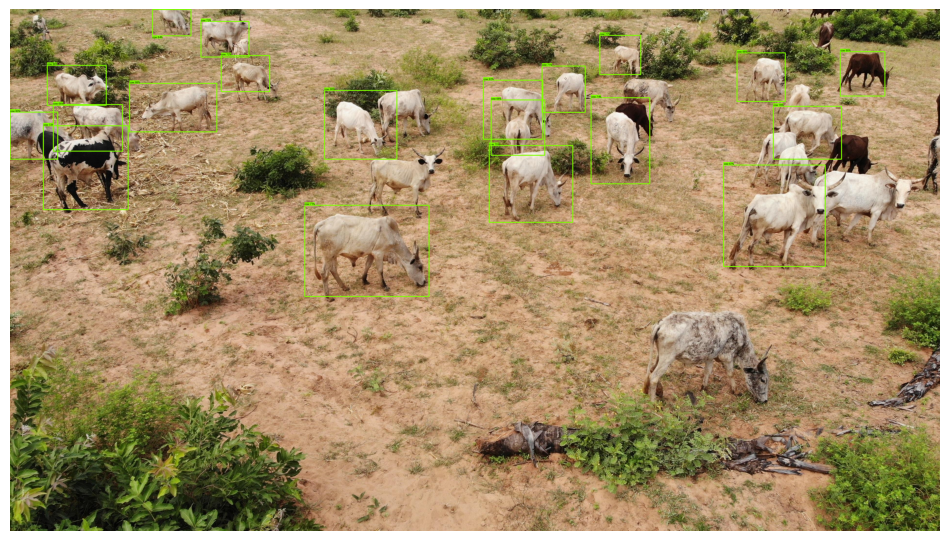

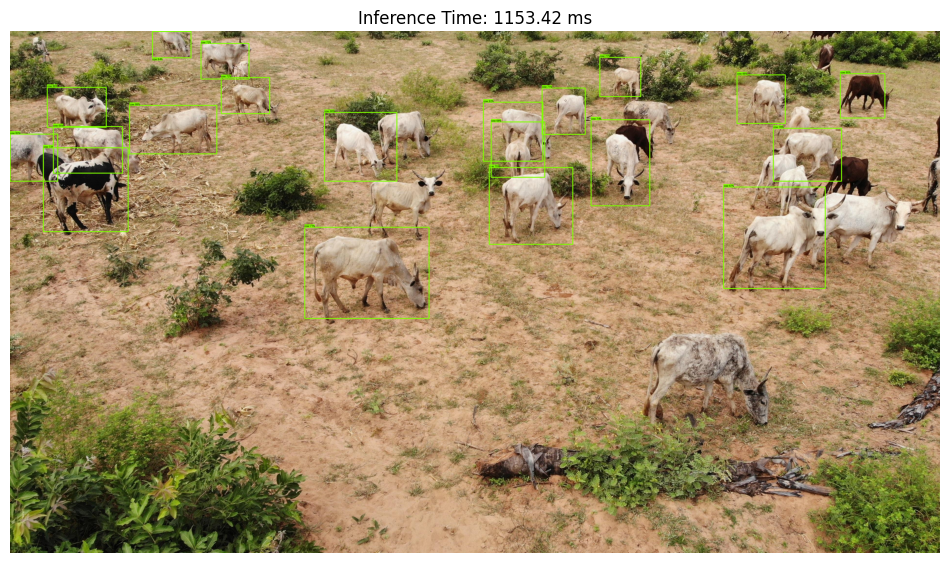

In [ ]:
%matplotlib inline
import numpy as np
import os
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils
import time  # For timing inference

# Paths
PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/JPEGImages/DJI_0008.JPG"

# Load model
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH)

# Load and convert image
image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]

# Run inference with timing
start_time = time.time()
detections = detect_fn(input_tensor)
end_time = time.time()

# Calculate inference time in milliseconds
inference_time_ms = (end_time - start_time) * 1000
print(f"Inference time: {inference_time_ms:.2f} ms")

# Format detections
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)

# Optional: print top 10 detection scores
print("Top detection scores:", detections['detection_scores'][:10])

# Visualization
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.3,
    agnostic_mode=False)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.title(f"Inference Time: {inference_time_ms:.2f} ms")
plt.show()


Inference time: 1115.86 ms
Top detection scores: [0.8791741  0.8778093  0.8601252  0.8406482  0.8176336  0.8036716
 0.79915005 0.782885   0.766163   0.74827075]


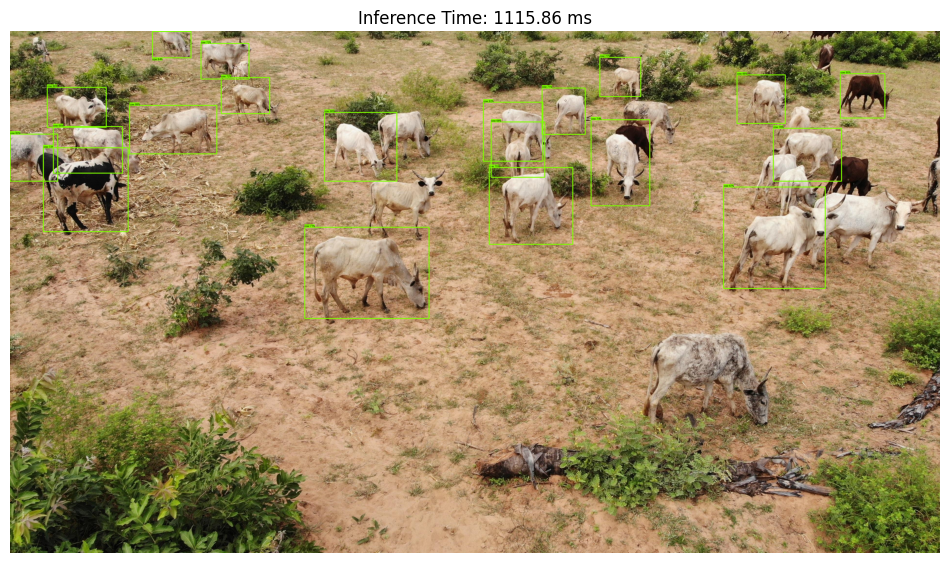

In [ ]:
%matplotlib inline
import numpy as np
import os
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils
import time  # For timing inference

# Paths
PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/dataset_tf_2025/JPEGImages/DJI_0008.JPG"

# Load model
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH)

# Load and convert image
image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]

# Run inference with timing
start_time = time.time()
detections = detect_fn(input_tensor)
end_time = time.time()

# Calculate inference time in milliseconds
inference_time_ms = (end_time - start_time) * 1000
print(f"Inference time: {inference_time_ms:.2f} ms")

# Format detections
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)

# Optional: print top 10 detection scores
print("Top detection scores:", detections['detection_scores'][:10])

# Visualization
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.3,
    agnostic_mode=False)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.title(f"Inference Time: {inference_time_ms:.2f} ms")
plt.show()


In [32]:
!pip install tensorflow==2.15

  Using cached tensorflow-2.15.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (4.4 kB)
Using cached tensorflow-2.15.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (475.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dopamine-rl 4.1.2 requires jax>=0.1.72, which is not installed.
dopamine-rl 4.1.2 requires jaxlib>=0.1.51, which is not installed.
tf-models-official 2.19.1 requires tensorflow~=2.19.0, but you have tensorflow 2.15.0 which is incompatible.
tf-keras 2.19.0 requires tensorflow<2.20,>=2.19, but you have tensorflow 2.15.0 which is incompatible.
tensorflow-text 2.19.0 requires tensorflow<2.20,>=2.19.0, but you have tensorflow 2.15.0 which is incompatible.
tensorflow-decision-forests 1.12.0 requires tensorflow==2.19.0, but you have tensorflow 2.15.0 which is incompatible.
keras-hub 0.21.1 requires keras>=3.5, but

In [28]:
# Uninstall both first
!pip uninstall -y numpy tensorflow

# Reinstall compatible versions
!pip install numpy==1.25.2 tensorflow==2.13.0

Found existing installation: numpy 1.25.2
Uninstalling numpy-1.25.2:
  Successfully uninstalled numpy-1.25.2
Found existing installation: tensorflow 2.15.0
Uninstalling tensorflow-2.15.0:
  Successfully uninstalled tensorflow-2.15.0
  Using cached numpy-1.25.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (5.6 kB)
  Using cached tensorflow-2.13.0-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.4 kB)
  Using cached keras-2.13.1-py3-none-any.whl.metadata (2.4 kB)
INFO: pip is looking at multiple versions of tensorflow to determine which version is compatible with other requirements. This could take a while.
ERROR: Cannot install numpy==1.25.2 and tensorflow==2.13.0 because these package versions have conflicting dependencies.

The conflict is caused by:
    The user requested numpy==1.25.2
    tensorflow 2.13.0 depends on numpy<=1.24.3 and >=1.22

To fix this you could try to:
1. loosen the range of package versions you've specified
2. remove 

In [36]:
!pip install numpy==1.26.4

In [ ]:
# Downgrade numpy before importing TensorFlow
!pip install numpy==1.26.4 --quiet
import os
os.kill(os.getpid(), 9)  # Restart the runtime so change takes effect

In [1]:
%matplotlib inline
import numpy as np
import os
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils

# Paths
PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0012.JPG"

# Load model
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH)

# Load and convert image
image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]

# Run inference
detections = detect_fn(input_tensor)

# Format detections
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)

# Debug: print scores
print("Detection scores:", detections['detection_scores'][:10])

# Visualization
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.3,  # Lower threshold if nothing shows
    agnostic_mode=False)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.show()


Detection scores: [0.8932533  0.7843491  0.74261254 0.74051166 0.6838481  0.6678761
 0.66554517 0.64515203 0.6349451  0.62266135]


Loading model from: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model
Loading label map from: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt
Total Detections: 100
1: cow - Score: 0.893
2: cow - Score: 0.784
3: cow - Score: 0.743
4: cow - Score: 0.741
5: cow - Score: 0.684
6: cow - Score: 0.668
7: cow - Score: 0.666
8: cow - Score: 0.645
9: cow - Score: 0.635
10: cow - Score: 0.623


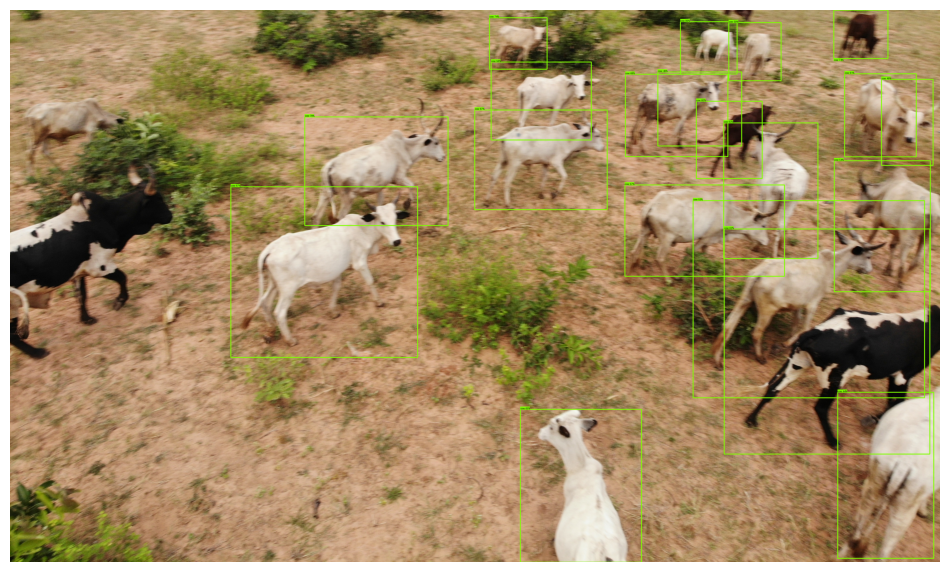

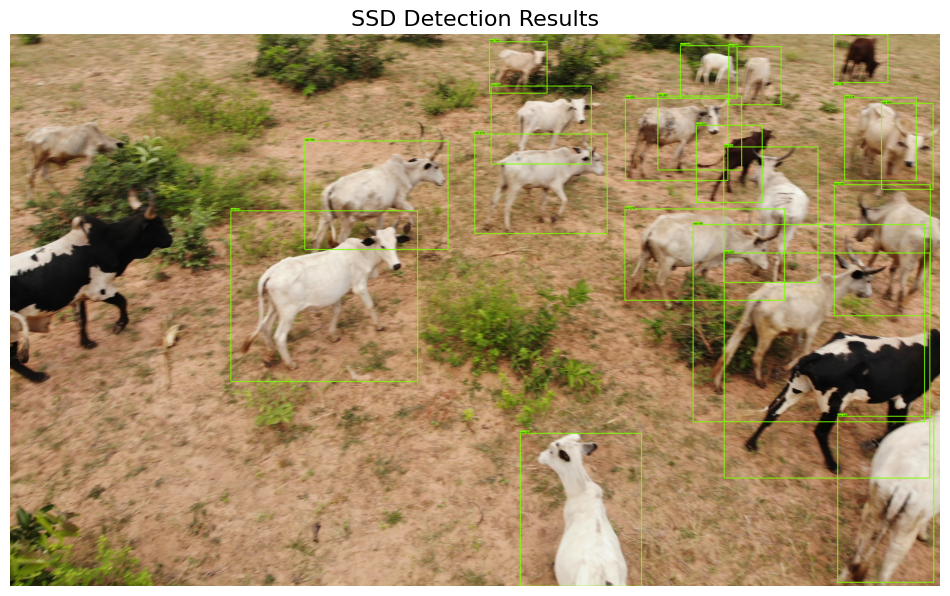

In [2]:
%matplotlib inline
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils


PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0012.JPG"


print("Loading model from:", PATH_TO_SAVED_MODEL)
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

print("Loading label map from:", LABEL_MAP_PATH)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH, use_display_name=True)


image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]


detections = detect_fn(input_tensor)

# Convert outputs to numpy arrays
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)


print(f"Total Detections: {num_detections}")
for i in range(min(10, num_detections)):
    cls_id = detections['detection_classes'][i]
    score = detections['detection_scores'][i]
    if cls_id in category_index:
        label = category_index[cls_id]['name']
    else:
        label = f"Class {cls_id}"
    print(f"{i+1}: {label} - Score: {score:.3f}")


image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.05,  # Lower threshold to see all detections
    agnostic_mode=False,
    skip_scores=False,
    skip_labels=False
)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.title("SSD Detection Results", fontsize=16)
plt.show()


Loading model from: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model
Loading label map from: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt
Total Detections: 100
1: cow - Score: 0.817
2: cow - Score: 0.791
3: cow - Score: 0.789
4: cow - Score: 0.788
5: cow - Score: 0.784
6: cow - Score: 0.777
7: cow - Score: 0.741
8: cow - Score: 0.739
9: cow - Score: 0.735
10: cow - Score: 0.733


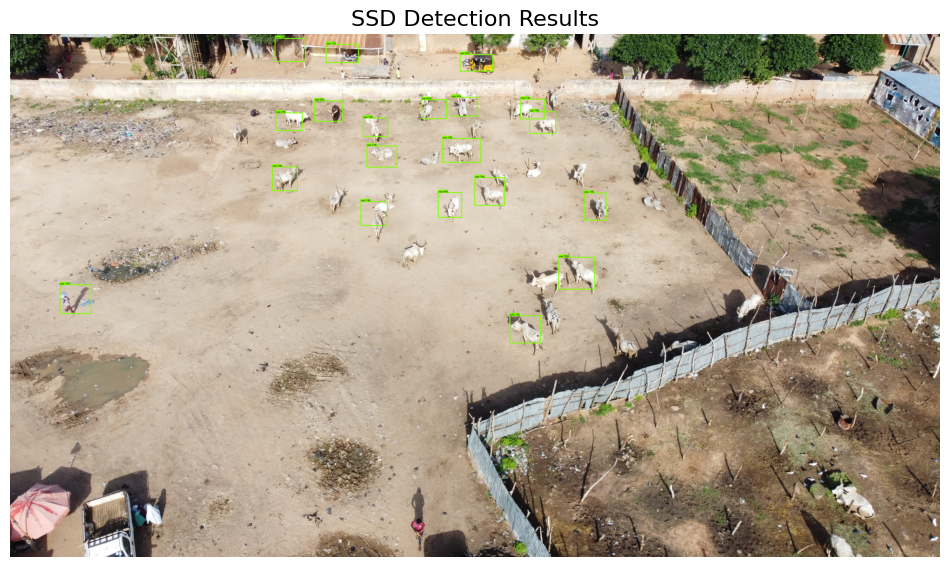

In [3]:
%matplotlib inline
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils


PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0305.JPG"


print("Loading model from:", PATH_TO_SAVED_MODEL)
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

print("Loading label map from:", LABEL_MAP_PATH)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH, use_display_name=True)


image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]


detections = detect_fn(input_tensor)

# Convert outputs to numpy arrays
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)


print(f"Total Detections: {num_detections}")
for i in range(min(10, num_detections)):
    cls_id = detections['detection_classes'][i]
    score = detections['detection_scores'][i]
    if cls_id in category_index:
        label = category_index[cls_id]['name']
    else:
        label = f"Class {cls_id}"
    print(f"{i+1}: {label} - Score: {score:.3f}")


image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.05,  # Lower threshold to see all detections
    agnostic_mode=False,
    skip_scores=False,
    skip_labels=False
)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.title("SSD Detection Results", fontsize=16)
plt.show()


Loading model from: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model
Loading label map from: /content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt
Total Detections: 100
1: cow - Score: 0.810
2: cow - Score: 0.785
3: cow - Score: 0.751
4: cow - Score: 0.734
5: cow - Score: 0.676
6: cow - Score: 0.660
7: cow - Score: 0.658
8: cow - Score: 0.646
9: cow - Score: 0.632
10: cow - Score: 0.608


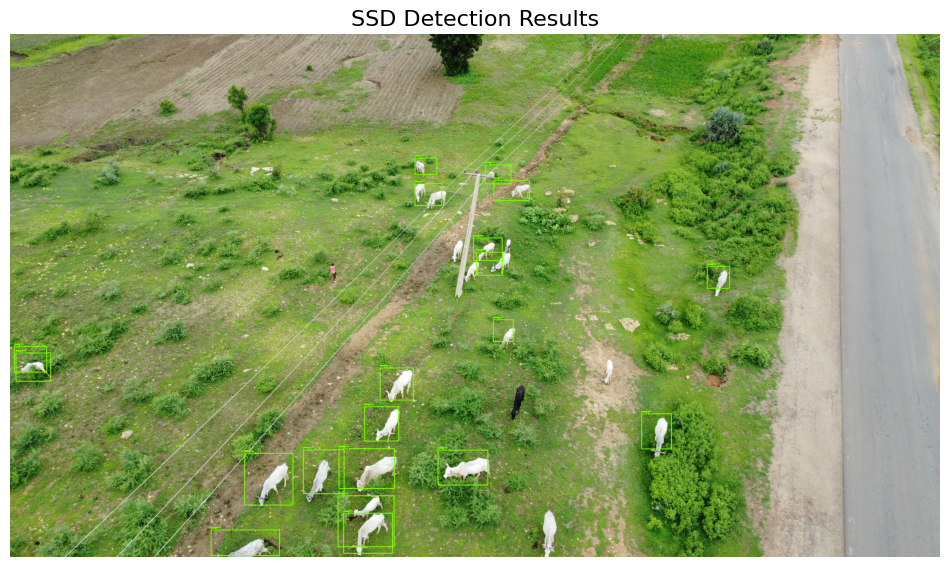

In [4]:
%matplotlib inline
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils


PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0450.JPG"


print("Loading model from:", PATH_TO_SAVED_MODEL)
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)

print("Loading label map from:", LABEL_MAP_PATH)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH, use_display_name=True)


image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]


detections = detect_fn(input_tensor)

# Convert outputs to numpy arrays
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)


print(f"Total Detections: {num_detections}")
for i in range(min(10, num_detections)):
    cls_id = detections['detection_classes'][i]
    score = detections['detection_scores'][i]
    if cls_id in category_index:
        label = category_index[cls_id]['name']
    else:
        label = f"Class {cls_id}"
    print(f"{i+1}: {label} - Score: {score:.3f}")


image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.05,  # Lower threshold to see all detections
    agnostic_mode=False,
    skip_scores=False,
    skip_labels=False
)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.title("SSD Detection Results", fontsize=16)
plt.show()


Inference time: 1175.11 ms
Top detection scores: [0.81701803 0.7907289  0.7888801  0.7877318  0.7838604  0.7765293
 0.7408417  0.73933834 0.73500484 0.7326117 ]


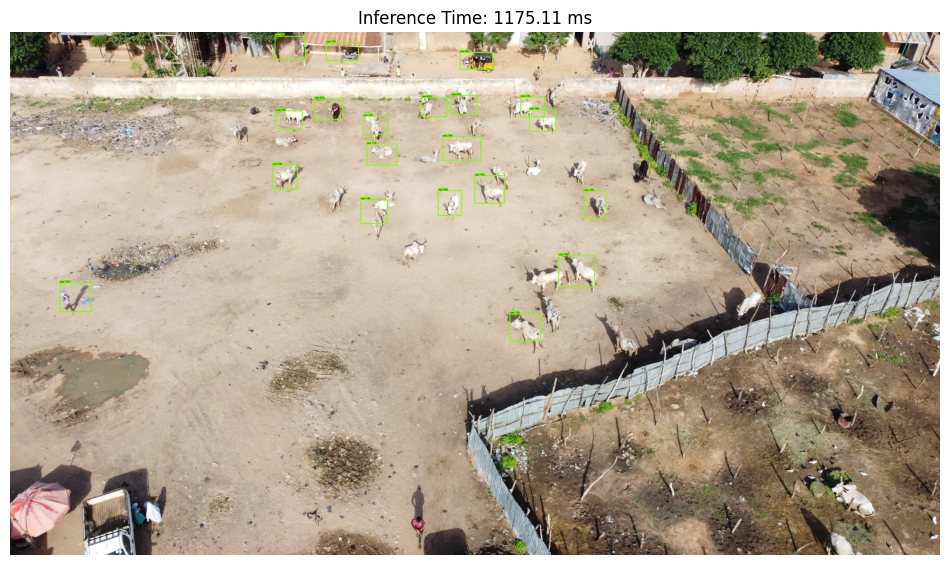

In [5]:
%matplotlib inline
import numpy as np
import os
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util, visualization_utils as viz_utils
import time  # For timing inference

# Paths
PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/exported_model/saved_model"
LABEL_MAP_PATH = "/content/drive/MyDrive/LivestockDetection2025/SSD_Training/label_map.pbtxt"
IMAGE_PATH = "/content/drive/MyDrive/LivestockDetection2025/testing_images/test/DJI_0305.JPG"

# Load model
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
category_index = label_map_util.create_category_index_from_labelmap(LABEL_MAP_PATH)

# Load and convert image
image = Image.open(IMAGE_PATH).convert("RGB")
image_np = np.array(image)
input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]

# Run inference with timing
start_time = time.time()
detections = detect_fn(input_tensor)
end_time = time.time()

# Calculate inference time in milliseconds
inference_time_ms = (end_time - start_time) * 1000
print(f"Inference time: {inference_time_ms:.2f} ms")

# Format detections
num_detections = int(detections.pop('num_detections'))
detections = {k: v[0, :num_detections].numpy() for k, v in detections.items()}
detections['num_detections'] = num_detections
detections['detection_classes'] = detections['detection_classes'].astype(np.int32)

# Optional: print top 10 detection scores
print("Top detection scores:", detections['detection_scores'][:10])

# Visualization
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
    image_np_with_detections,
    detections['detection_boxes'],
    detections['detection_classes'],
    detections['detection_scores'],
    category_index,
    use_normalized_coordinates=True,
    max_boxes_to_draw=20,
    min_score_thresh=0.3,
    agnostic_mode=False)

# Show image
plt.figure(figsize=(12, 8))
plt.imshow(image_np_with_detections)
plt.axis("off")
plt.title(f"Inference Time: {inference_time_ms:.2f} ms")
plt.show()
